<a href="https://colab.research.google.com/github/nurielw05/doc_transformers/blob/main/LayoutLMv2/FUNSD/True_inference_with_LayoutLMv2ForTokenClassification_%2B_Gradio_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Inference with LayoutLMv2ForTokenClassification + Gradio demo

In this notebook, we are going to perform inference with `LayoutLMv2ForTokenClassification` on new document images, when no label information is accessible. At the end, we will also make a cool [Gradio](https://gradio.app/) demo, that turns our inference code into a cool web interface.

## Install libraries

Let's first install the required libraries:
* HuggingFace Transformers + Detectron2 (for the model)
* HuggingFace Datasets (for getting the data)
* PyTesseract (for OCR)

In [13]:
!pip install -q transformers

In [14]:
!pip install pyyaml==5.1
# workaround: install old version of pytorch since detectron2 hasn't released packages for pytorch 1.9 (issue: https://github.com/facebookresearch/detectron2/issues/3158)
!pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# install detectron2 that matches pytorch 1.8
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install -q detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
#exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html


In [15]:
!pip install -q datasets

In [16]:
!sudo apt install tesseract-ocr
!pip install -q pytesseract

Reading package lists... Done
Building dependency tree       
Reading state information... Done
tesseract-ocr is already the newest version (4.00~git2288-10f4998a-2).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 19 not upgraded.


## Load dataset

We load the FUNSD dataset from the hub, which I uploaded.

In [17]:
from datasets import load_dataset 

datasets = load_dataset("nielsr/funsd")

  0%|          | 0/2 [00:00<?, ?it/s]

Let's create a list containing all unique labels, as well as dictionaries mapping integers to their label names and vice versa. This will be useful to convert the model's predictions to actual label names.

In [18]:
labels = datasets['train'].features['ner_tags'].feature.names
print(labels)

['O', 'B-HEADER', 'I-HEADER', 'B-QUESTION', 'I-QUESTION', 'B-ANSWER', 'I-ANSWER']


In [19]:
id2label = {v: k for v, k in enumerate(labels)}
label2id = {k: v for v, k in enumerate(labels)}
label2id

{'B-ANSWER': 5,
 'B-HEADER': 1,
 'B-QUESTION': 3,
 'I-ANSWER': 6,
 'I-HEADER': 2,
 'I-QUESTION': 4,
 'O': 0}

## Inference

Let's test the trained model on the first image of the test set:

In [20]:
example = datasets["test"][1]
print(example.keys())

dict_keys(['id', 'words', 'bboxes', 'ner_tags', 'image_path'])


We can visualize the document image using PIL:

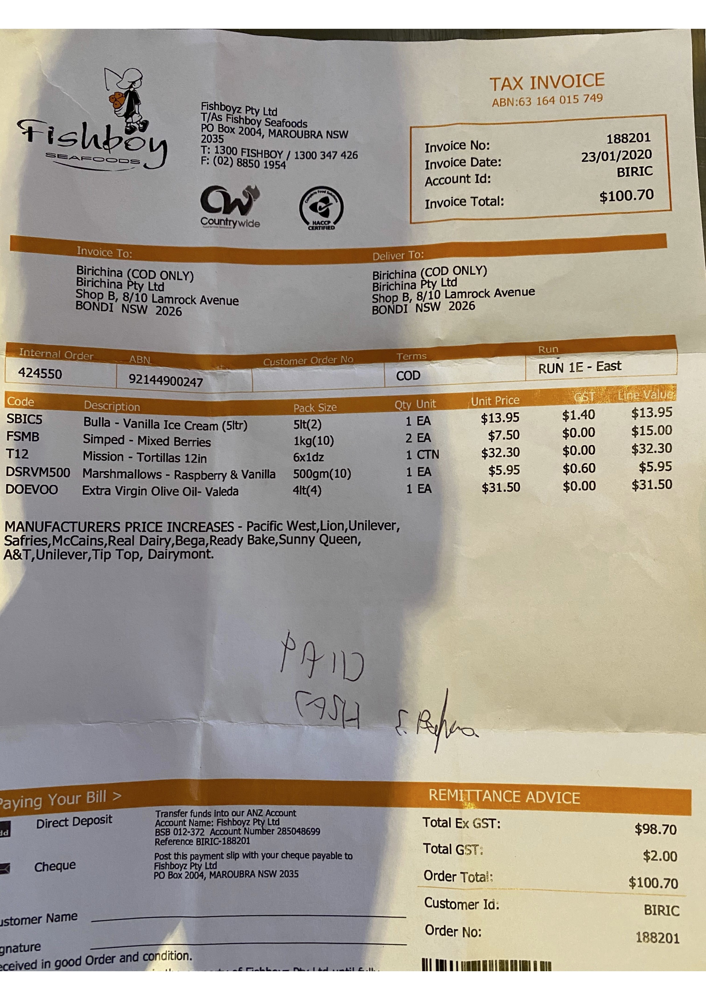

In [163]:
from PIL import Image, ImageDraw, ImageFont

image = Image.open("/content/1112223331.jpg")
image = image.convert("RGB")
image

We prepare it for the model using `LayoutLMv2Processor`.

In [164]:
from transformers import LayoutLMv2Processor

processor = LayoutLMv2Processor.from_pretrained("microsoft/layoutlmv2-base-uncased")

encoding = processor(image, return_offsets_mapping=True, return_tensors="pt")
offset_mapping = encoding.pop('offset_mapping')
print(encoding.keys())

dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'bbox', 'image'])


Next, let's move everything to the GPU, if it's available.

In [165]:
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

for k,v in encoding.items():
  encoding[k] = v.to(device)

In [166]:
from transformers import LayoutLMv2ForTokenClassification

# load the fine-tuned model from the hub
model = LayoutLMv2ForTokenClassification.from_pretrained("nielsr/layoutlmv2-finetuned-funsd")
model.to(device)

# forward pass
outputs = model(**encoding)
print(outputs.logits.shape)

torch.Size([1, 481, 7])


Let's create the true predictions as well as the true boxes. With "true", I mean only taking into account tokens that are at the start of a given word. We can use the `offset_mapping` returned by the processor to determine which tokens are a subword.

In [183]:
def unnormalize_box(bbox, width, height):
     return [
         width * (bbox[0] / 1000),
         height * (bbox[1] / 1000),
         width * (bbox[2] / 1000),
         height * (bbox[3] / 1000),
     ]

predictions = outputs.logits.argmax(-1).squeeze().tolist()
token_boxes = encoding.bbox.squeeze().tolist()

width, height = image.size

In [168]:
import numpy as np

is_subword = np.array(offset_mapping.squeeze().tolist())[:,0] != 0

true_predictions = [id2label[pred] for idx, pred in enumerate(predictions) if not is_subword[idx]]
true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(token_boxes) if not is_subword[idx]]

In [169]:
print(true_predictions)
print(true_boxes)

['I-ANSWER', 'B-HEADER', 'B-HEADER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-QUESTION', 'O', 'O', 'O', 'B-ANSWER', 'B-ANSWER', 'I-ANSWER', 'O', 'B-ANSWER', 'O', 'O', 'O', 'O', 'B-ANSWER', 'O', 'O', 'O', 'O', 'B-QUESTION', 'I-QUESTION', 'O', 'B-QUESTION', 'B-ANSWER', 'B-ANSWER', 'O', 'B-QUESTION', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-QUESTION', 'I-QUESTION', 'B-ANSWER', 'B-QUESTION', 'I-QUESTION', 'B-ANSWER', 'O', 'O', 'O', 'B-QUESTION', 'I-QUESTION', 'B-ANSWER', 'O', 'O', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-QUESTION', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'I-ANSWER', 'B-QUESTION', 'I-QUESTION', 'I-QUESTION', 'I-QUESTION', 'I-QUEST

In [170]:
image = Image.open(example['image_path'])
draw = ImageDraw.Draw(image)
image = image.convert("RGB")
finalBoxes = []

for label, box in zip(true_predictions, true_boxes,):
  finalBoxes.append([label, box])
  


print(finalBoxes)
print(len(finalBoxes))

[['I-ANSWER', [-100.0, 0.0, 0.0, 0.0]], ['B-HEADER', [593.0, 76.0, 739.9999999999999, 90.0]], ['B-HEADER', [651.0, 72.0, 856.0, 89.0]], ['B-ANSWER', [185.0, 101.0, 342.0, 114.0]], ['I-ANSWER', [247.0, 105.0, 367.0, 115.99999999999999]], ['I-ANSWER', [273.0, 107.0, 392.0, 115.99999999999999]], ['B-QUESTION', [597.0, 97.0, 752.0000000000001, 106.0]], ['O', [661.0, 96.0, 785.0, 105.0]], ['O', [693.0000000000001, 94.0, 819.0000000000001, 103.0]], ['O', [726.0, 93.0, 853.0, 102.0]], ['B-ANSWER', [184.0, 112.0, 314.0, 122.0]], ['B-ANSWER', [220.0, 112.99999999999999, 369.99999999999994, 127.0]], ['I-ANSWER', [275.0, 118.00000000000001, 435.0, 127.0]], ['O', [-75.0, 119.0, 38.0, 130.0]], ['B-ANSWER', [185.0, 123.0, 302.0, 132.0]], ['O', [208.0, 123.0, 316.99999999999994, 132.0]], ['O', [-69.0, 126.00000000000001, 76.0, 144.0]], ['O', [-19.0, 131.0, 109.00000000000001, 146.0]], ['O', [15.0, 120.99999999999999, 206.0, 153.0]], ['B-ANSWER', [185.0, 126.00000000000001, 333.0, 143.0]], ['O', [238.

In [171]:
image = Image.open(example['image_path'])
image = image.convert("RGB")
DrawBOXES = []
finalDraw = []
draw = ImageDraw.Draw(image)

for i in range(len(finalBoxes)):
  if(finalBoxes[i][0] == "B-QUESTION" or finalBoxes[i][0] == "B-ANSWER"):
    DrawBOXES.append([finalBoxes[i][1]])
  if(finalBoxes[i][0] == "I-QUESTION" or finalBoxes[i][0] == "I-ANSWER"):
    if(i == 0):
      DrawBOXES.append([finalBoxes[i][1]])
    else:
     DrawBOXES[len(DrawBOXES)-1].append(finalBoxes[i][1])


x = range(len(DrawBOXES))

for i in x:
  if(len(DrawBOXES[i])!=1):
    finalDraw.append([[DrawBOXES[i][0][0],DrawBOXES[i][0][1],DrawBOXES[i][len(DrawBOXES[i])-1][2],DrawBOXES[i][len(DrawBOXES[i])-1][3]]])
  else:
    finalDraw.append(DrawBOXES[i])

print(finalDraw)

[[[-100.0, 0.0, 0.0, 0.0]], [[185.0, 101.0, 392.0, 115.99999999999999]], [[597.0, 97.0, 752.0000000000001, 106.0]], [[184.0, 112.0, 314.0, 122.0]], [[220.0, 112.99999999999999, 435.0, 127.0]], [[185.0, 123.0, 302.0, 132.0]], [[185.0, 126.00000000000001, 333.0, 143.0]], [[502.0, 140.0, 693.0, 149.0]], [[184.0, 145.0, 297.0, 153.0]], [[204.0, 145.0, 336.00000000000006, 155.0]], [[241.0, 147.0, 392.0, 158.0]], [[185.0, 156.0, 296.0, 164.0]], [[202.0, 155.0, 411.0, 169.0]], [[316.99999999999994, 151.0, 506.0, 159.0]], [[502.0, 157.0, 709.0, 166.0]], [[724.0, 149.0, 924.0, 175.0]], [[501.0, 174.0, 694.0, 183.0]], [[773.9999999999999, 166.0, 912.0000000000001, 177.0]], [[502.0, 196.0, 713.0000000000001, 206.0]], [[749.0, 188.0, 925.0, 204.0]], [[8.0, 265.0, 274.0, 282.0]], [[428.0, 269.0, 689.0, 276.0]], [[18.0, 278.0, 232.0, 291.0]], [[428.0, 281.0, 618.0, 289.0]], [[7.0, 289.0, 293.0, 304.0]], [[7.0, 300.0, 338.0, 305.0]], [[427.0, 293.0, 757.0, 297.0]], [[427.0, 295.0, 672.0000000000001, 

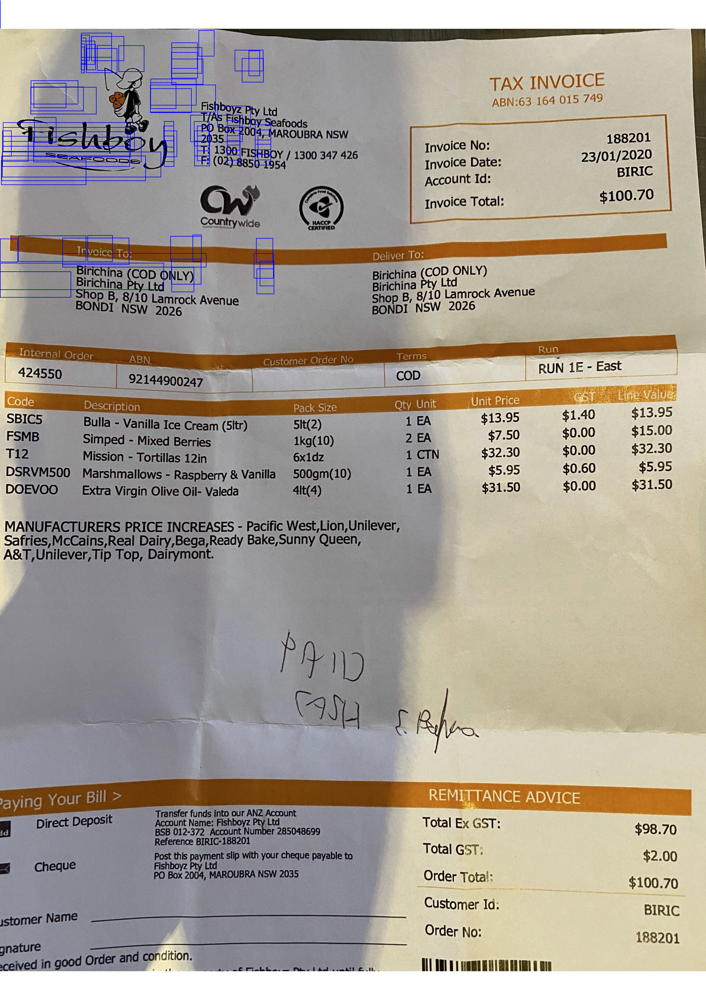

In [182]:
image = Image.open("/content/1112223331.jpg")
image = image.convert("RGB")
finalBoxes = []
draw = ImageDraw.Draw(image)

for box in finalDraw:
  box = unnormalize_box(box[0], width, height)
  draw.rectangle(box, outline='blue', width=2)

image

Let's visualize the result!

In [110]:
image = Image.open(example['image_path'])
draw = ImageDraw.Draw(image)
image = image.convert("RGB")
finalBoxes = []

for label, box, word in zip(example['ner_tags'], example['bboxes'], example['words']):
  finalBoxes.append([id2label[label], box, word])
  


print(finalBoxes)
print(len(finalBoxes))

[['B-QUESTION', [99, 140, 123, 153], 'TO:'], ['B-QUESTION', [99, 168, 144, 181], 'FROM:'], ['B-ANSWER', [839, 198, 850, 208], 'x'], ['B-QUESTION', [99, 223, 168, 234], 'SUBJECT:'], ['B-HEADER', [98, 348, 164, 361], 'DIVISION:'], ['B-QUESTION', [120, 374, 189, 388], 'DIVISION:'], ['B-QUESTION', [122, 404, 188, 415], 'DIVISION:'], ['B-QUESTION', [124, 433, 189, 444], 'DIVISION:'], ['B-QUESTION', [99, 293, 156, 306], 'REGION:'], ['B-QUESTION', [513, 374, 575, 388], 'DIVISION:'], ['B-QUESTION', [513, 404, 575, 417], 'DIVISION:'], ['B-QUESTION', [509, 432, 578, 445], 'DIVISION:'], ['B-ANSWER', [444, 587, 470, 598], '225'], ['B-ANSWER', [448, 601, 466, 614], '27'], ['B-ANSWER', [452, 617, 466, 628], '15'], ['B-ANSWER', [448, 649, 466, 662], '31'], ['B-ANSWER', [449, 666, 466, 676], '18'], ['B-ANSWER', [452, 680, 469, 693], '19'], ['B-ANSWER', [448, 697, 468, 708], '20'], ['O', [895, 774, 923, 879], '82200067'], ['O', [112, 77, 136, 87], '09/'], ['O', [139, 77, 163, 87], '17/'], ['O', [163, 7

In [112]:
image = Image.open(example['image_path'])
image = image.convert("RGB")
DrawBOXES = []
finalDraw = []
draw = ImageDraw.Draw(image)

for i in range(len(finalBoxes)):
  if(finalBoxes[i][0] == "B-QUESTION" or finalBoxes[i][0] == "B-ANSWER"):
    DrawBOXES.append([finalBoxes[i][1]])
  if(finalBoxes[i][0] == "I-QUESTION" or finalBoxes[i][0] == "I-ANSWER"):
    if(i == 0):
      DrawBOXES.append([finalBoxes[i][1]])
    else:
      DrawBOXES[len(DrawBOXES)-1].append(finalBoxes[i][1])


x = range(len(DrawBOXES))

for i in x:
  if(len(DrawBOXES[i])!=1):
    finalDraw.append([[DrawBOXES[i][0][0],DrawBOXES[i][0][1],DrawBOXES[i][len(DrawBOXES[i])-1][2],DrawBOXES[i][len(DrawBOXES[i])-1][3]]])
  else:
    finalDraw.append(DrawBOXES[i])

print(finalDraw)

[[[99, 140, 123, 153]], [[99, 168, 144, 181]], [[839, 198, 850, 208]], [[99, 223, 168, 234]], [[120, 374, 189, 388]], [[122, 404, 188, 415]], [[124, 433, 189, 444]], [[99, 293, 156, 306]], [[513, 374, 575, 388]], [[513, 404, 575, 417]], [[509, 432, 578, 445]], [[444, 587, 470, 598]], [[448, 601, 466, 614]], [[452, 617, 466, 628]], [[448, 649, 466, 662]], [[449, 666, 466, 676]], [[452, 680, 469, 693]], [[448, 697, 468, 708]], [[298, 142, 387, 154]], [[298, 169, 380, 181]], [[755, 170, 799, 181]], [[750, 198, 799, 208]], [[598, 169, 649, 180]], [[602, 197, 651, 208]], [[99, 320, 513, 333]], [[204, 376, 375, 387]], [[204, 404, 379, 415]], [[201, 432, 366, 444]], [[587, 377, 785, 387]], [[584, 402, 785, 417]], [[587, 433, 785, 443]], [[129, 570, 263, 584]], [[322, 573, 379, 581]], [[440, 559, 490, 582]], [[545, 570, 675, 582]], [[724, 571, 785, 581]], [[824, 556, 877, 583]], [[102, 588, 204, 598]], [[102, 602, 214, 613]], [[102, 617, 194, 630]], [[102, 648, 163, 660]], [[99, 663, 152, 678]

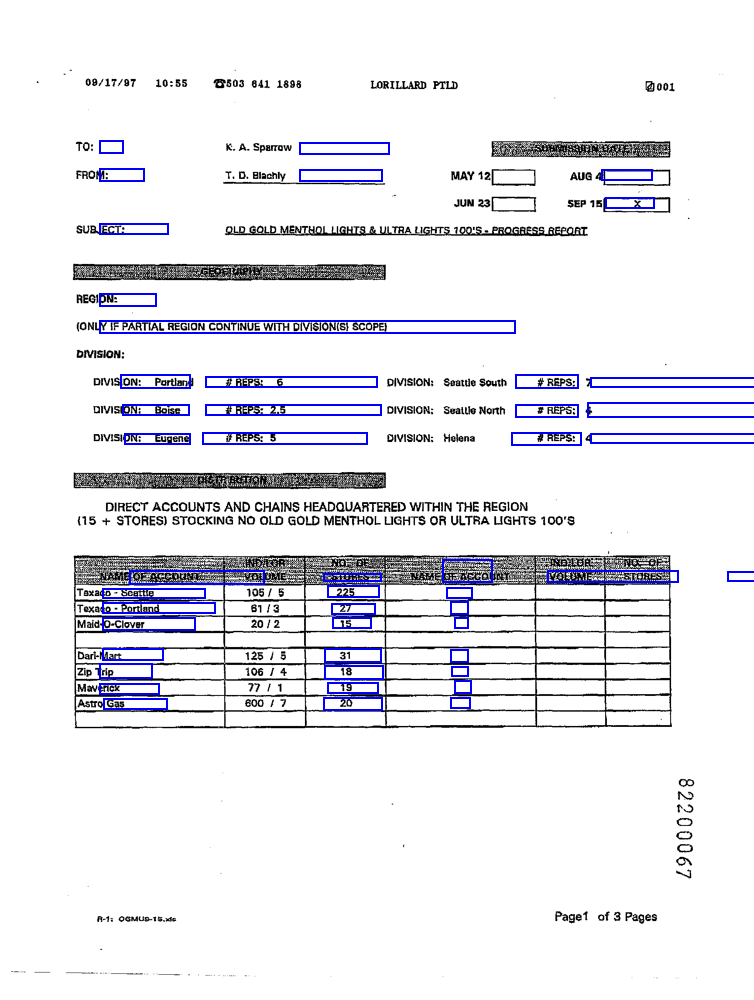

In [115]:
image = Image.open(example['image_path'])
image = image.convert("RGB")
finalBoxes = []
draw = ImageDraw.Draw(image)

for box in finalDraw:
  box = unnormalize_box(box[0], width, height)
  draw.rectangle(box, outline='blue', width=2)

image

As we can see, results aren't as good as previously. This can be explained by the fact that we're using a different OCR engine than the one that was used during fine-tuning.

Compare this to the ground truth:

In [ ]:
image = Image.open(example['image_path'])
image = image.convert("RGB")

draw = ImageDraw.Draw(image)

for word, box, label in zip(example['words'], example['bboxes'], example['ner_tags']):
  actual_label = iob_to_label(id2label[label]).lower()
  box = unnormalize_box(box, width, height)
  draw.rectangle(box, outline=label2color[actual_label], width=2)
  draw.text((box[0] + 10, box[1] - 10), actual_label, fill=label2color[actual_label], font=font)

image

## Gradio demo

We can also, based on the code above, create a quick [Gradio](https://gradio.app/) demo, which creates a web interface that enables people to quickly test the model.

Gradio is very easy to set up, as can be seen below.

In [ ]:
!pip install -q gradio

In [ ]:
import os
os.system('pip install git+https://github.com/huggingface/transformers.git --upgrade')
os.system('pip install pyyaml==5.1')
# workaround: install old version of pytorch since detectron2 hasn't released packages for pytorch 1.9 (issue: https://github.com/facebookresearch/detectron2/issues/3158)
os.system('pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html')

# install detectron2 that matches pytorch 1.8
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
os.system('pip install -q detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html')

## install PyTesseract
os.system('pip install -q pytesseract')

import gradio as gr
import numpy as np
from transformers import LayoutLMv2Processor, LayoutLMv2ForTokenClassification
from datasets import load_dataset
from PIL import Image, ImageDraw, ImageFont

processor = LayoutLMv2Processor.from_pretrained("microsoft/layoutlmv2-base-uncased")
model = LayoutLMv2ForTokenClassification.from_pretrained("nielsr/layoutlmv2-finetuned-funsd")

# load image example
dataset = load_dataset("nielsr/funsd", split="test")
image = Image.open(dataset[0]["image_path"]).convert("RGB")
image.save("document.png")
# define id2label, label2color
labels = dataset.features['ner_tags'].feature.names
id2label = {v: k for v, k in enumerate(labels)}
label2color = {'question':'blue', 'answer':'green', 'header':'orange', 'other':'violet'}

def unnormalize_box(bbox, width, height):
     return [
         width * (bbox[0] / 1000),
         height * (bbox[1] / 1000),
         width * (bbox[2] / 1000),
         height * (bbox[3] / 1000),
     ]

def iob_to_label(label):
    label = label[2:]
    if not label:
      return 'other'
    return label

def process_image(image):
    width, height = image.size

    # encode
    encoding = processor(image, truncation=True, return_offsets_mapping=True, return_tensors="pt")
    offset_mapping = encoding.pop('offset_mapping')

    # forward pass
    outputs = model(**encoding)

    # get predictions
    predictions = outputs.logits.argmax(-1).squeeze().tolist()
    token_boxes = encoding.bbox.squeeze().tolist()

    # only keep non-subword predictions
    is_subword = np.array(offset_mapping.squeeze().tolist())[:,0] != 0
    true_predictions = [id2label[pred] for idx, pred in enumerate(predictions) if not is_subword[idx]]
    true_boxes = [unnormalize_box(box, width, height) for idx, box in enumerate(token_boxes) if not is_subword[idx]]

    # draw predictions over the image
    draw = ImageDraw.Draw(image)
    font = ImageFont.load_default()
    for prediction, box in zip(true_predictions, true_boxes):
        predicted_label = iob_to_label(prediction).lower()
        draw.rectangle(box, outline=label2color[predicted_label])
        draw.text((box[0]+10, box[1]-10), text=predicted_label, fill=label2color[predicted_label], font=font)
    
    return image

title = "Interactive demo: LayoutLMv2"
description = "Demo for Microsoft's LayoutLMv2, a Transformer for state-of-the-art document image understanding tasks. This particular model is fine-tuned on FUNSD, a dataset of manually annotated forms. It annotates the words into QUESTION/ANSWER/HEADER/OTHER. To use it, simply upload an image or use the example image below. Results will show up in a few seconds."
article = "<p style='text-align: center'><a href='https://arxiv.org/abs/2012.14740'>LayoutLMv2: Multi-modal Pre-training for Visually-Rich Document Understanding</a> | <a href='https://github.com/microsoft/unilm'>Github Repo</a></p>"
examples =[['document.png']]

css = """.output_image, .input_image {height: 600px !important}"""

iface = gr.Interface(fn=process_image, 
                     inputs=gr.inputs.Image(type="pil"), 
                     outputs=gr.outputs.Image(type="pil", label="annotated image"),
                     title=title,
                     description=description,
                     article=article,
                     examples=examples,
                     css=css)
iface.launch(debug=True)